In [50]:
# Read the CSV file
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.model_selection import train_test_split
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
freqData=pd.read_csv("C:/Users/adity/OneDrive/Desktop/Sixth Semester/CE6018 Seismic Data Analytics/Program/Week8/Data folder/Time_Envelop.csv")
freqData

,Mag,Rjb,logRjb,logVS_30,H,FM,TimeI_ 7,TimeI_ 8,TimeI_ 9,TimeI_ 10,...,TimeI_217,TimeI_218,TimeI_219,TimeI_220,TimeI_221,TimeI_222,TimeI_223,TimeI_224,TimeI_225,TimeI_226
0,6.0,2.07,0.727549,6.385784,6.000,0,-8.939370,-9.651052,-10.092627,-10.017340,...,-34.538776,-34.538776,-34.538776,-34.538776,-34.538776,-34.538776,-34.538776,-34.538776,-34.538776,-34.538776
1,6.0,2.09,0.737164,6.313222,6.000,0,-17.553074,-18.260476,-17.988382,-16.687192,...,-34.538776,-34.538776,-34.538776,-34.538776,-34.538776,-34.538776,-34.538776,-34.538776,-34.538776,-34.538776
2,5.8,71.28,4.266616,5.390486,10.000,0,-14.002430,-14.820205,-14.273970,-13.674100,...,-34.538776,-34.538776,-34.538776,-34.538776,-34.538776,-34.538776,-34.538776,-34.538776,-34.538776,-34.538776
3,5.0,32.44,3.479392,5.363356,16.000,0,-13.408328,-11.319629,-10.378323,-10.105061,...,-34.538776,-34.538776,-34.538776,-34.538776,-34.538776,-34.538776,-34.538776,-34.538776,-34.538776,-34.538776
4,5.5,52.73,3.965185,5.390486,10.000,0,-13.251003,-13.844489,-13.608041,-12.431513,...,-34.538776,-34.538776,-34.538776,-34.538776,-34.538776,-34.538776,-34.538776,-34.538776,-34.538776,-34.538776
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14184,4.1,54.82,4.004055,6.633318,13.322,0,-26.786335,-27.861755,-28.085299,-28.196764,...,-22.465883,-21.974376,-22.188652,-21.735354,-20.985284,-21.327259,-21.880422,-22.516206,-23.384968,-23.615026
14185,4.1,52.51,3.961004,6.633318,13.322,0,-24.407003,-24.813333,-24.836344,-24.793932,...,-26.592453,-26.297105,-26.254179,-26.143062,-25.882365,-25.389976,-34.538776,-34.538776,-34.538776,-34.538776
14186,4.1,49.78,3.907613,6.117370,13.322,0,-24.289614,-25.046237,-25.026952,-24.924563,...,-21.569619,-22.197226,-22.811678,-22.715406,-22.686602,-23.100374,-23.458480,-23.811142,-23.495687,-23.297321
14187,4.1,81.12,4.395930,6.329061,13.322,0,-27.003316,-27.644214,-27.706107,-27.812432,...,-27.193699,-27.765102,-28.786023,-29.080659,-28.966495,-28.904614,-28.862714,-28.359591,-34.538776,-34.538776


In [51]:
# Plot the scatter plot with colors
all_columns = list(freqData.columns)
X_val = all_columns[:6]
# Y_val = all_columns[6:157]
Y_val = all_columns[6:]

Xreq= freqData[X_val]
Yreq = freqData[Y_val] # Yreq is the response variable



# Normalizing the data
scalerX = MinMaxScaler()
scalerY = MinMaxScaler()
X_normalized = scalerX.fit_transform(Xreq)
Y_normalized = scalerY.fit_transform(Yreq)


# Split the data into training, validation, and test sets
X_train, X_test, y_train, y_test = train_test_split(
    X_normalized, Y_normalized, test_size=0.2, random_state=42)


Epoch 1, Loss: 0.042334056105202356, MSE: 0.042334056105202356
Epoch 2, Loss: 0.025126133943107767, MSE: 0.025126133943107767
Epoch 3, Loss: 0.023893343240127596, MSE: 0.023893343240127596
Epoch 4, Loss: 0.02327404989742897, MSE: 0.02327404989742897
Epoch 5, Loss: 0.02281856325415658, MSE: 0.02281856325415658
Epoch 6, Loss: 0.022594951124678197, MSE: 0.022594951124678197
Epoch 7, Loss: 0.02245916653634377, MSE: 0.02245916653634377
Epoch 8, Loss: 0.0222131514239689, MSE: 0.0222131514239689
Epoch 9, Loss: 0.022014844732385287, MSE: 0.022014844732385287
Epoch 10, Loss: 0.021834208627401944, MSE: 0.021834208627401944
Epoch 11, Loss: 0.021731414864967828, MSE: 0.021731414864967828
Epoch 12, Loss: 0.021586229088125936, MSE: 0.021586229088125936
Epoch 13, Loss: 0.02157157843958744, MSE: 0.02157157843958744
Epoch 14, Loss: 0.021412790010512713, MSE: 0.021412790010512713
Epoch 15, Loss: 0.021256445968707263, MSE: 0.021256445968707263
Epoch 16, Loss: 0.021129094549572805, MSE: 0.0211290945495728

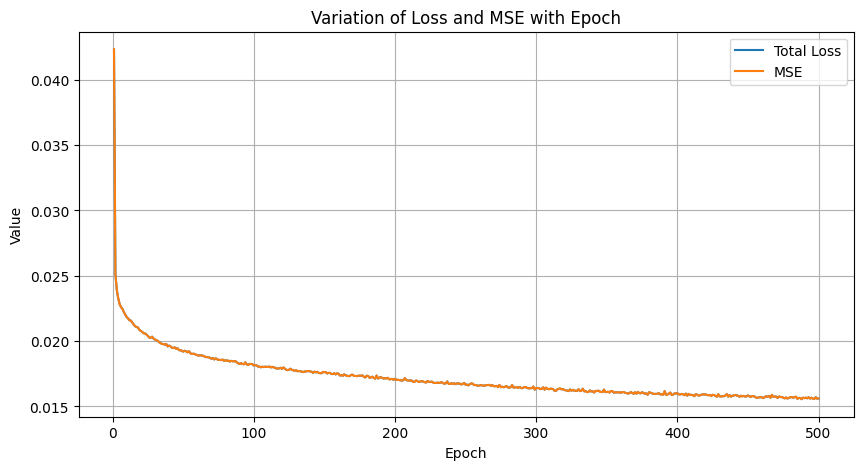

In [52]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset
import numpy as np
import torch.nn.functional as F
import matplotlib.pyplot as plt

class BayesianNetwork(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim):
        super(BayesianNetwork, self).__init__()
        self.fc1 = nn.Linear(input_dim, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, output_dim)

    def forward(self, x):
        x = torch.relu(self.fc1(x))
        x = self.fc2(x)
        return x

class ProbabilisticBNN(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim, dropout_rate=0.5):
        super(ProbabilisticBNN, self).__init__()
        self.network = BayesianNetwork(input_dim, hidden_dim, output_dim)
        self.dropout_rate = dropout_rate

    def forward(self, x):
        output = self.network(x)
        return output

    def mc_dropout_forward(self, x, n_samples=20):
        predictions = []
        for _ in range(n_samples):
            with torch.no_grad():
                output = F.dropout(self.network(x), p=self.dropout_rate, training=True)
            predictions.append(output.unsqueeze(0))
        predictions = torch.cat(predictions, dim=0)
        mean_prediction = predictions.mean(dim=0)
        std_prediction = predictions.std(dim=0)
        return mean_prediction, std_prediction

    def kl_divergence(self):
        kl_div = 0
        for module in self.modules():
            if hasattr(module, 'kl_loss'):
                kl_div += module.kl_loss()
        return kl_div

def train(model, train_loader, optimizer, criterion, epochs=100):
    model.train()
    mse_values = []
    loss_values = []
    for epoch in range(epochs):
        total_loss = 0
        total_mse = 0
        for inputs, targets in train_loader:
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, targets) + model.kl_divergence()  # Add KL divergence to the loss
            mse = criterion(outputs, targets).item()
            loss.backward()
            optimizer.step()
            total_loss += loss.item()
            total_mse += mse
        avg_loss = total_loss / len(train_loader)
        avg_mse = total_mse / len(train_loader)
        loss_values.append(avg_loss)
        mse_values.append(avg_mse)
        print(f'Epoch {epoch+1}, Loss: {avg_loss}, MSE: {avg_mse}')
    
    # Plotting
    plt.figure(figsize=(10, 5))
    plt.plot(range(1, epochs + 1), loss_values, label='Total Loss')
    plt.plot(range(1, epochs + 1), mse_values, label='MSE')
    plt.xlabel('Epoch')
    plt.ylabel('Value')
    plt.title('Variation of Loss and MSE with Epoch')
    plt.legend()
    plt.grid(True)
    plt.show()

def test(model, test_loader):
    model.eval()
    predictions = []
    actuals = []
    with torch.no_grad():
        for inputs, targets in test_loader:
            outputs = model(inputs)
            predictions.extend(outputs.numpy())
            actuals.extend(targets.numpy())
    
    predictions = np.array(predictions)
    actuals = np.array(actuals)
    return predictions, actuals

# Example usage:
# Assuming you have input data X_train, y_train, X_test, and y_test

# Convert your data into PyTorch tensors
X_train = torch.tensor(X_train, dtype=torch.float32)
y_train = torch.tensor(y_train, dtype=torch.float32)
X_test = torch.tensor(X_test, dtype=torch.float32)
y_test = torch.tensor(y_test, dtype=torch.float32)

# Create DataLoader for training
train_data = TensorDataset(X_train, y_train)
train_loader = DataLoader(train_data, batch_size=32, shuffle=True)


# Define model, optimizer, and loss function
input_dim = X_train.shape[1]
output_dim = y_train.shape[1]  # Assuming regression task with single output
hidden_dim = 100
learning_rate = 0.001
dropout_rate = 0.5  # Dropout rate for MC Dropout
model = ProbabilisticBNN(input_dim, hidden_dim, output_dim, dropout_rate)
optimizer = optim.Adam(model.parameters(), lr=learning_rate)
criterion = nn.MSELoss()

# Train the model
train(model, train_loader, optimizer, criterion, epochs=500)


In [53]:
# torch.save(model.state_dict(), 'C:/Users/adity/OneDrive/Desktop/Sixth Semester/CE6018 Seismic Data Analytics/Program/Week8/BNNresult/model_for_freqEnv_500epoch.pth')


In [54]:
# # Check if the file exists
# import os


# file_path = 'C:/Users/adity/OneDrive/Desktop/Sixth Semester/CE6018 Seismic Data Analytics/Program/Week8/BNNresult/model_for_freqEnv_500epoch.pth'
# if os.path.isfile(file_path):
#     model = torch.load(file_path)
# else:
#     print(f"File {file_path} does not exist. Please check the file path.")
# model=torch.load('C:/Users/adity/OneDrive/Desktop/Sixth Semester/CE6018 Seismic Data Analytics/Program/Week8/BNNresult/model_for_freqEnv_500epoch.pth')

In [55]:
#creating datalaoder for test data
test_data = TensorDataset(X_test, y_test)
test_loader = DataLoader(test_data, batch_size=32)
# # Test the model
predictions, actuals = test(model, test_loader)

In [56]:
#converting the normalized data back to original data
predictions = scalerY.inverse_transform(predictions)
actuals = scalerY.inverse_transform(actuals)


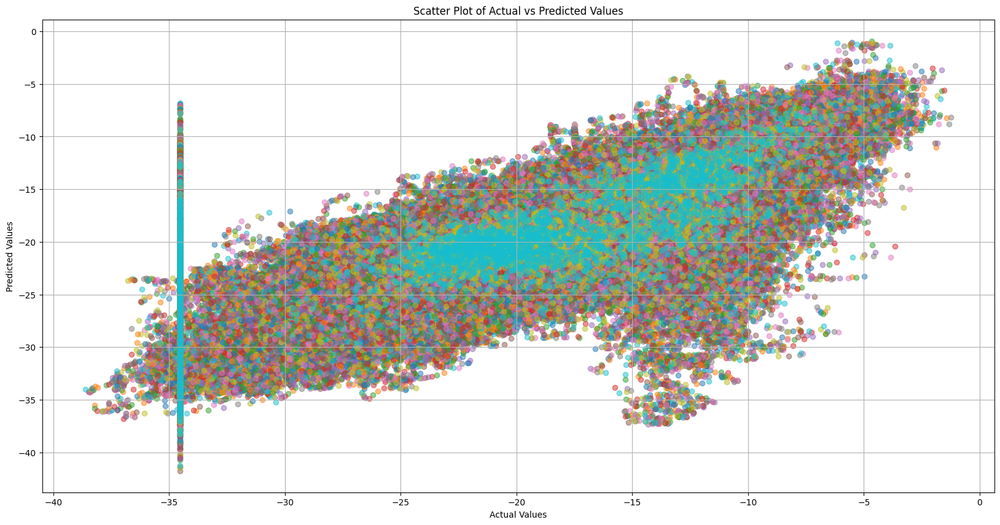

In [57]:
plt.figure(figsize=(20, 10))

# Loop over all subarrays
for i in range(actuals.shape[1]):
    plt.scatter(actuals[:,i], predictions[:,i], alpha=0.5)
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Scatter Plot of Actual vs Predicted Values')
plt.grid(True)
plt.show()

In [58]:

from sklearn.metrics import mean_squared_error, r2_score


# Calculate MSE and R2 score
mse = mean_squared_error(actuals, predictions)
r2 = r2_score(actuals, predictions)
print(f'Mean Squared Error: {mse}')
print(f'R2 Score: {r2}')

# Calculation of confidence intervals
mean_predictions, std_predictions = model.mc_dropout_forward(X_test)
confidence_intervals = (mean_predictions - 2 * std_predictions, mean_predictions + 2 * std_predictions)


Mean Squared Error: 19.1278018951416
R2 Score: 0.6162977463472231


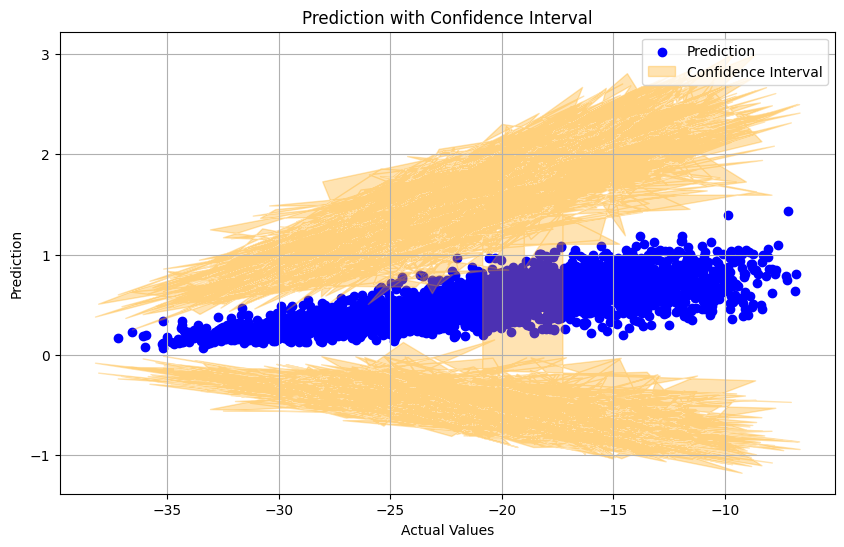

In [59]:
# Plotting the confidence intervals
plt.figure(figsize=(10, 6))
plt.scatter(actuals[:, 0], mean_predictions[:, 0], label='Prediction', color='blue')
plt.fill_between(actuals[:, 1], confidence_intervals[0][:, 1], confidence_intervals[1][:, 1], alpha=0.3, label='Confidence Interval', color='orange')
plt.xlabel('Actual Values')
plt.ylabel('Prediction')
plt.title('Prediction with Confidence Interval')
plt.legend()
plt.grid(True)
plt.show()

In [60]:

# Convert the tensors to numpy arrays
y_test = y_test.numpy()
mean_predictions = mean_predictions.numpy()
lower_confidence_intervals = confidence_intervals[0].numpy()
upper_confidence_intervals = confidence_intervals[1].numpy()
std_predictions = std_predictions.numpy()

In [61]:
#using the normalized means and stds to make a dataframe for epistemic and aleatoric uncertainty calculation
mean_predictions_df = pd.DataFrame(mean_predictions, columns=Y_val)
std_predictions_df = pd.DataFrame(std_predictions, columns=Y_val)

In [62]:
#converting to actual values
y_test = scalerY.inverse_transform(y_test)
mean_predictions = scalerY.inverse_transform(mean_predictions)
lower_confidence_intervals = scalerY.inverse_transform(lower_confidence_intervals)
upper_confidence_intervals = scalerY.inverse_transform(upper_confidence_intervals)


Ytestdf= pd.DataFrame(y_test, columns=Y_val)
Ypreddf= pd.DataFrame(mean_predictions, columns=Y_val)
Ylowerdf= pd.DataFrame(lower_confidence_intervals, columns=Y_val)
Yupperdf= pd.DataFrame(upper_confidence_intervals, columns=Y_val)

In [63]:
#Making a data frame having actual , predicted and confidence interval values for each column
finalDf=pd.DataFrame({f"Actual_{Y_val[0]}":Ytestdf[Y_val[0]], f"Predicted_{Y_val[0]}":Ypreddf[Y_val[0]], f"Lower Confidence Interval_{Y_val[0]}":Ylowerdf[Y_val[0]], f"Upper Confidence Interval_{Y_val[0]}":Yupperdf[Y_val[0]]})
for i in range(len(Y_val)-1):
    finalDf=pd.concat([finalDf,pd.DataFrame({f"Actual_{Y_val[i+1]}":Ytestdf[Y_val[i+1]], f"Predicted_{Y_val[i+1]}":Ypreddf[Y_val[i+1]], f"Lower Confidence Interval_{Y_val[i+1]}":Ylowerdf[Y_val[i+1]], f"Upper Confidence Interval_{Y_val[i+1]}":Yupperdf[Y_val[i+1]]})], axis=1,join='inner')

# Save the data frame to a CSV file
# finalDf.to_csv("C:/Users/adity/OneDrive/Desktop/Sixth Semester/CE6018 Seismic Data Analytics/Program/Week7/BNNresult/Resultfreq.csv", index=False)



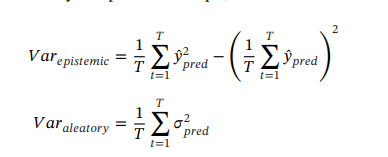

In [64]:
var_aleatory = std_predictions_df.pow(2).mean()
var_epistemic = mean_predictions_df.var()
UncertainityStats = pd.DataFrame({'Aleatory Uncertainty': var_aleatory, 'Epistemic Uncertainty': var_epistemic})
UncertainityStats.to_csv("C:/Users/adity/OneDrive/Desktop/Sixth Semester/CE6018 Seismic Data Analytics/Program/Week8/BNNresult/UncertainityStats.csv", index=False)
UncertainityStats

,Aleatory Uncertainty,Epistemic Uncertainty
TimeI_ 7,0.303603,0.045515
TimeI_ 8,0.311687,0.044042
TimeI_ 9,0.292915,0.042167
TimeI_ 10,0.279859,0.042149
TimeI_ 11,0.259340,0.037705
...,...,...
TimeI_222,0.300679,0.043372
TimeI_223,0.293095,0.042164
TimeI_224,0.301681,0.044931
TimeI_225,0.289365,0.045408


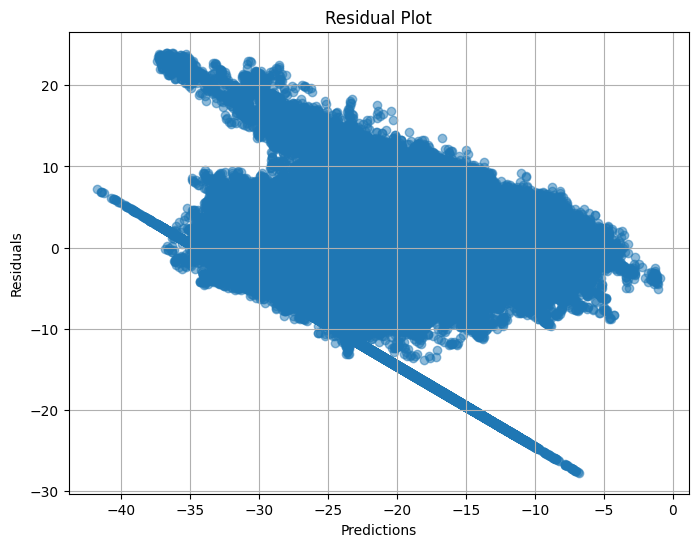

In [65]:
#plotting the residual plot
residuals = actuals - predictions
plt.figure(figsize=(8, 6))
plt.scatter(predictions, residuals, alpha=0.5)
plt.xlabel('Predictions')
plt.ylabel('Residuals')
plt.title('Residual Plot')
plt.grid(True)
plt.show()


In [66]:
X_test=scalerX.inverse_transform(X_test)
residualsdf=pd.DataFrame(residuals,columns=Y_val)
x_testdf=pd.DataFrame(X_test,columns=X_val)
TotalReidualDf= pd.concat([x_testdf,residualsdf],join='inner',axis="columns")
TotalReidualDf


,Mag,Rjb,logRjb,logVS_30,H,FM,TimeI_ 7,TimeI_ 8,TimeI_ 9,TimeI_ 10,...,TimeI_217,TimeI_218,TimeI_219,TimeI_220,TimeI_221,TimeI_222,TimeI_223,TimeI_224,TimeI_225,TimeI_226
0,6.61,290.490002,5.671569,6.018107,12.500000,0.0,0.529856,0.161522,0.086348,-0.051189,...,-1.285634,-0.711784,-0.856381,-1.193890,-1.986640,-2.779553,-2.633642,-2.546638,-2.425201,-2.380717
1,4.92,44.909999,3.804660,6.054932,6.300000,0.0,2.809803,2.173693,1.990780,1.839975,...,-12.650627,-12.558203,-12.336697,-12.374496,-12.319983,-12.316664,-12.237158,-12.231062,-12.268967,-12.165400
2,4.20,71.219997,4.265773,5.661084,7.507000,0.0,-0.066360,0.226440,0.194401,0.243437,...,0.118050,0.396412,0.714968,0.614004,0.537207,0.922670,1.407471,1.699364,1.674654,1.499647
3,4.45,108.879999,4.690246,5.642793,14.795001,0.0,3.022326,3.176600,3.163294,3.218374,...,1.494131,0.546303,0.700462,1.144901,1.275949,0.743044,-0.160765,0.117531,0.111881,0.726652
4,3.78,96.279998,4.567260,5.918894,14.930000,0.0,-1.978922,-1.854637,-1.875631,-1.818550,...,-1.535696,-1.843838,-1.284761,-0.418510,0.030064,-1.298857,-2.186300,-0.570652,-1.194378,-0.991119
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2833,6.61,304.179988,5.717620,6.283724,12.500000,0.0,-0.794657,-0.856913,-0.847204,-0.993776,...,1.013026,0.901526,1.104805,1.241228,0.998183,0.649846,0.959601,0.985683,1.403360,1.241050
2834,5.90,1.410000,0.343590,6.371680,6.000000,1.0,-1.058894,-0.917775,-1.121781,-1.546380,...,-0.099598,-0.041958,0.090736,0.109669,0.137577,0.073139,0.029140,0.022747,0.026764,-0.099213
2835,4.34,35.809998,3.578227,5.616771,9.557000,0.0,-1.660271,-1.613462,-1.647840,-1.668818,...,2.930710,3.568369,3.853357,4.144186,4.008177,3.820650,3.689373,4.147364,4.250557,4.141623
2836,5.39,51.019999,3.932218,5.774986,14.890001,3.0,-0.243475,-0.586861,-1.322798,-1.516806,...,5.426334,5.103171,4.950076,4.710763,4.777111,5.093024,5.280179,4.541610,3.329718,3.921169


In [67]:
#taking 10 equal intervals between the minimum and maximum value of the x_test and finding the mean and standard deviation of the residuals in each interval and plotting it
colno=1
x_test = x_testdf[X_val[colno]]
num_intervals = 10
interval_size = (x_test.max() - x_test.min()) / num_intervals
interval_means = []
interval_stds = []
for i in range(num_intervals):
    lower_bound = x_test.min() + i * interval_size
    upper_bound = lower_bound + interval_size
    mask = (TotalReidualDf[X_val[colno]] >= lower_bound) & (TotalReidualDf[X_val[colno]] <= upper_bound)
    interval_means.append(list(TotalReidualDf.loc[mask].mean()))
    interval_stds.append(list(TotalReidualDf.loc[mask].std()))


In [68]:
interval_meansdf=pd.DataFrame(interval_means,columns=X_val+Y_val)
interval_stdsdf=pd.DataFrame(interval_stds,columns=X_val+Y_val)
interval_meansdf

,Mag,Rjb,logRjb,logVS_30,H,FM,TimeI_ 7,TimeI_ 8,TimeI_ 9,TimeI_ 10,...,TimeI_217,TimeI_218,TimeI_219,TimeI_220,TimeI_221,TimeI_222,TimeI_223,TimeI_224,TimeI_225,TimeI_226
0,5.233872,26.227249,907.973353,5.983738,10.102176,1.027618,0.190834,0.258030,0.288062,0.392751,...,-0.576926,-0.498643,-0.503377,-0.557954,-0.552462,-0.555141,-0.631030,-0.630288,-0.669237,-0.692349
1,5.256613,72.193379,4.258054,6.067263,10.393834,1.081290,-0.032813,-0.000457,0.002198,0.111662,...,-0.210757,-0.167903,-0.126919,-0.149856,-0.089006,-0.114043,-0.249232,-0.206452,-0.220787,-0.246282
2,5.289926,123.177167,4.807162,6.014928,10.329785,1.236170,0.056001,0.127024,0.143487,0.240341,...,-0.745554,-0.754980,-0.682487,-0.712730,-0.651602,-0.666137,-0.697721,-0.697716,-0.737865,-0.723874
3,5.543742,172.251270,5.145778,6.055082,9.869166,0.996732,-0.108968,-0.012511,0.021584,0.108108,...,-1.066643,-1.026113,-0.918408,-1.004629,-0.984372,-0.996585,-0.964225,-1.046310,-1.047194,-1.132420
4,5.717946,222.223216,5.401742,6.111787,9.188657,1.014851,-0.161654,-0.119846,-0.103797,-0.065279,...,-0.967790,-0.925240,-0.810765,-0.852549,-0.856552,-0.828904,-0.864667,-0.833190,-0.816638,-0.817796
5,5.938358,269.650740,5.595780,6.048968,9.259441,1.022388,0.196586,0.311574,0.324997,0.351159,...,-0.495069,-0.426773,-0.294440,-0.319692,-0.260865,-0.162192,-0.129420,-0.098687,-0.120858,-0.137341
6,5.286698,316.470185,5.756500,6.173969,9.367453,1.264151,-0.042389,-0.026782,-0.036824,-0.012890,...,-0.707603,-0.766657,-0.689130,-0.560013,-0.475465,-0.444946,-0.393894,-0.412980,-0.496561,-0.359555
7,4.630000,368.502352,5.909019,6.188321,10.422059,1.294118,0.149671,0.279494,0.311002,0.390793,...,-0.443800,-0.485245,-0.274827,-0.243025,-0.239002,-0.297135,-0.303449,-0.341769,-0.461561,-0.587414
8,5.078571,425.707149,6.053208,6.350359,7.575000,1.571429,0.064621,0.399558,0.374481,0.372539,...,-0.087185,-0.210254,-0.036443,-0.130201,0.071585,-0.016587,-0.155903,0.089093,0.161526,-0.001828
9,5.132500,467.840013,6.147511,5.973485,8.771750,0.000000,-0.490772,-0.561938,-0.579985,-0.699340,...,-0.551186,-0.912206,-0.502171,-0.608886,-0.718591,-0.249498,-0.637832,-0.742043,-0.660105,-0.877605


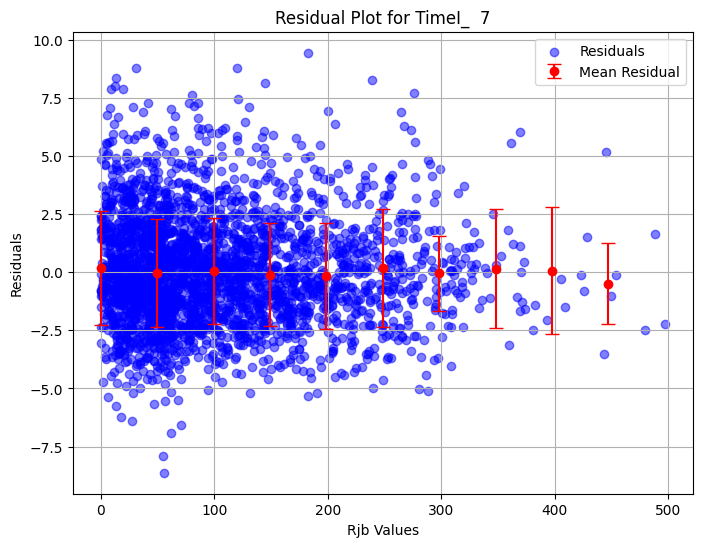

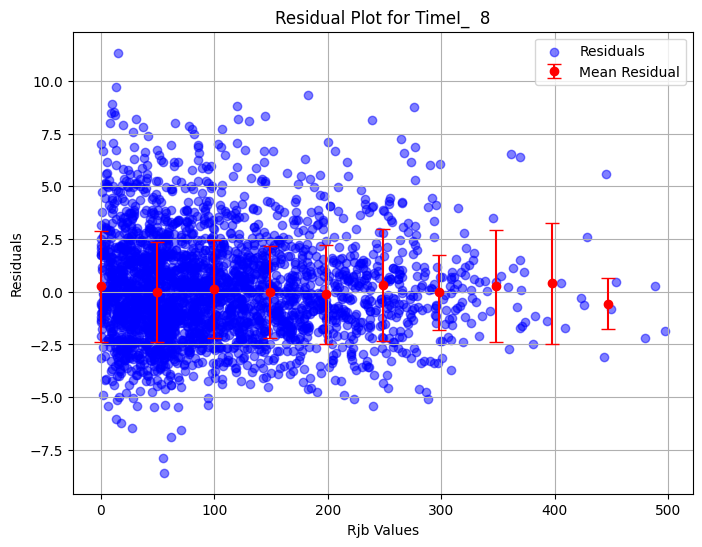

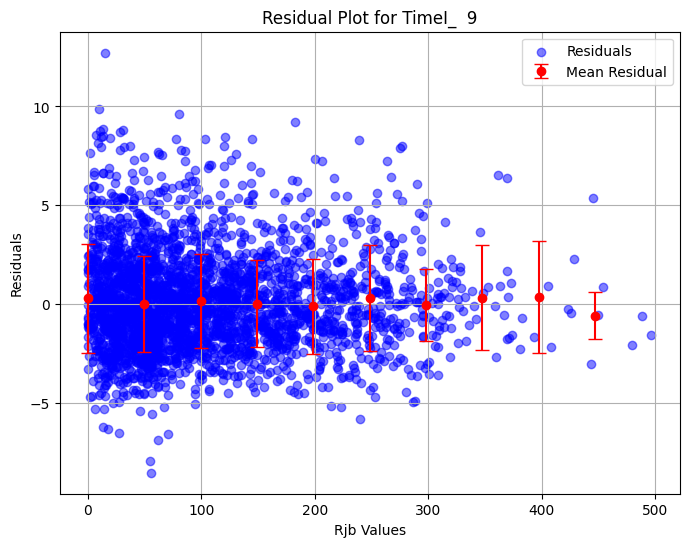

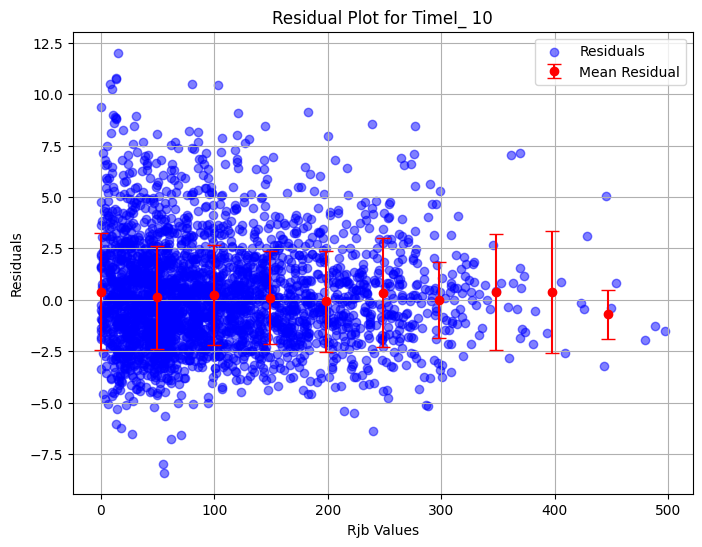

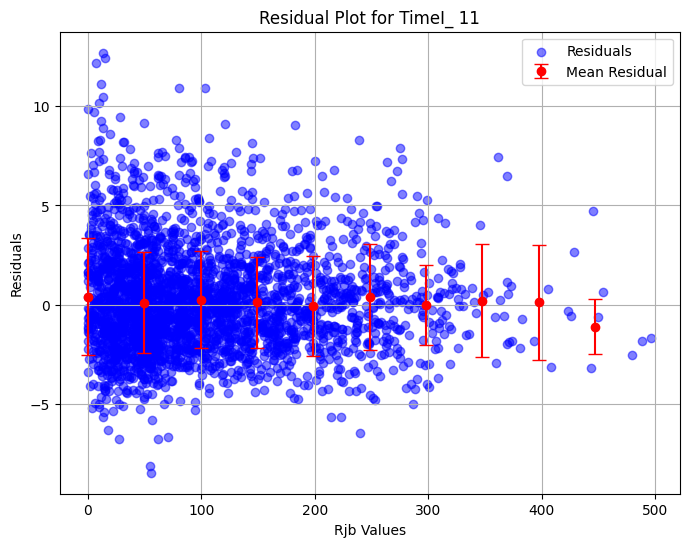

...

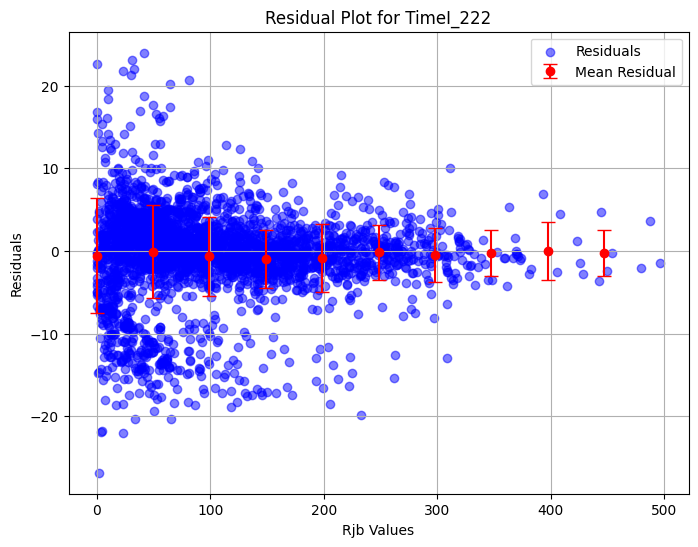

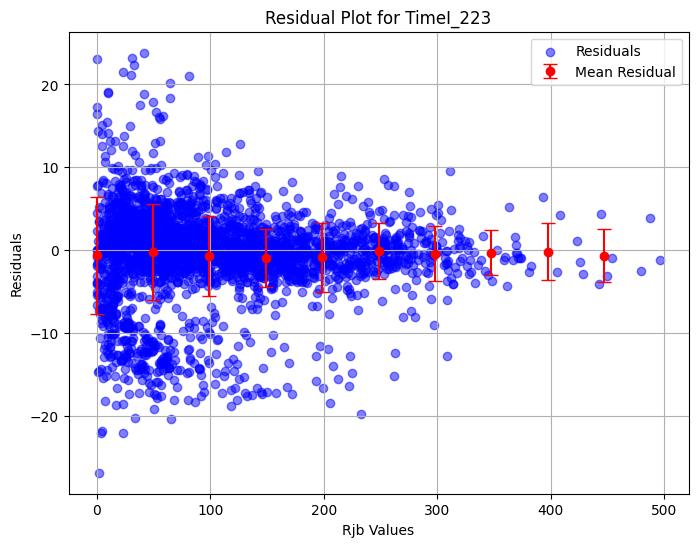

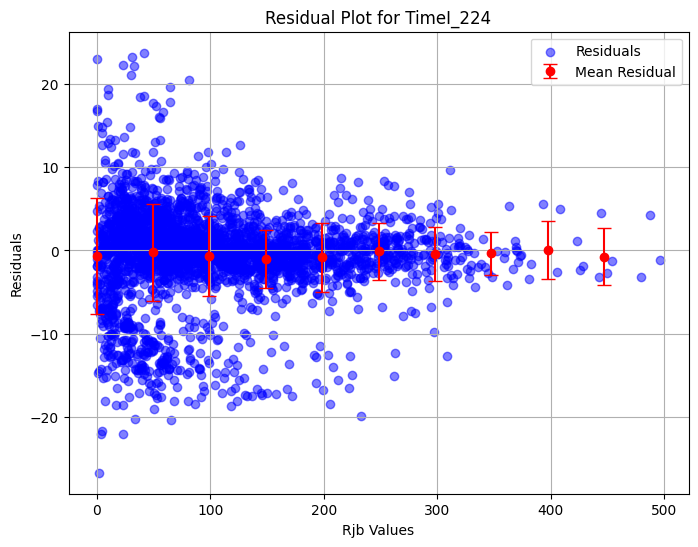

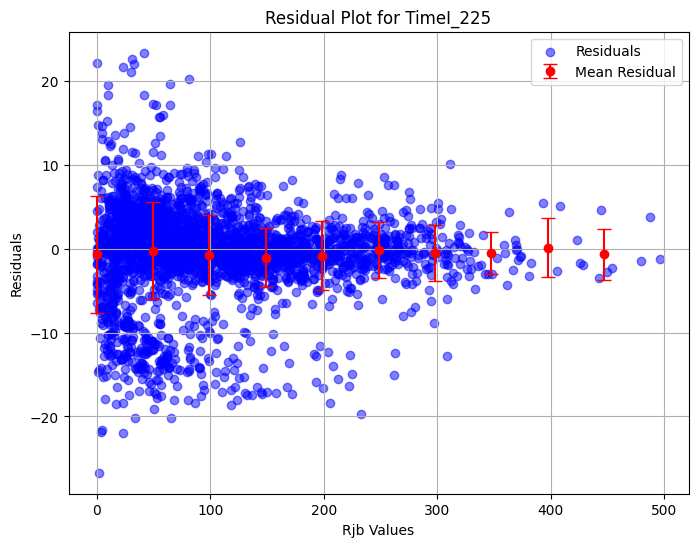

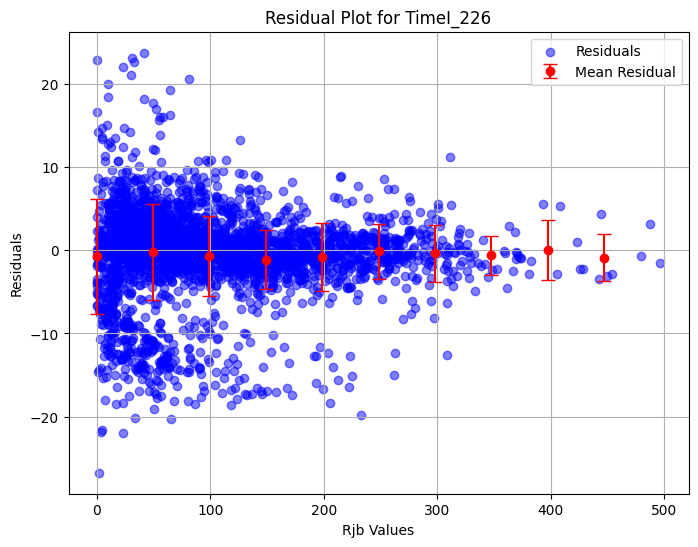

In [69]:
# plotting residual vs Rjb
for i in range(len(Y_val)):
    plt.figure(figsize=(8, 6))
    plt.scatter(x_testdf[X_val[colno]], TotalReidualDf[Y_val[i]], alpha=0.5, color='blue', label='Residuals')
    plt.errorbar(np.arange(num_intervals) * interval_size + x_test.min(), interval_meansdf[f"{Y_val[i]}"], yerr=interval_stdsdf[f"{Y_val[i]}"], fmt='o', capsize=5, label='Mean Residual',color='red')
    plt.xlabel('Rjb Values')
    plt.ylabel('Residuals')
    plt.title(f'Residual Plot for {Y_val[i]}')
    plt.grid(True)
    plt.legend()
    plt.show()